In [ ]:
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.patches import Patch
import pandas as pd
import numpy as np
import os
import collections
import mpl_stylesheet
mpl_stylesheet.banskt_presentation(fontfamily = 'mono', fontsize = 20, colors = 'banskt', dpi = 300)


In [7]:

basedir = "/biodata/franco/zsuzsa_lab/disprot_plotdata_OK_fullset/halft5/"
umap_datadict = dict()
for f in os.listdir(basedir):
    if f.startswith("umap"):
        print(f)
        arr = f[:-4].strip().split("_")
        neighbors = int(arr[1])
        dist      = float(arr[2])
        df = pd.read_table(basedir+f, sep=" ", header=None)
        key = f"{neighbors}_{dist}"
        umap_datadict[key] = df.values
    

umap_200_0.01.txt
umap_200_0.9.txt
umap_200_0.25.txt
umap_200_0.5.txt
umap_200_0.001.txt
umap_200_0.1.txt


In [8]:
# load seq and annotation data
seqfile = "disprot_plotdata_OK_fullset/halft5/seq_data.txt"
annfile = "disprot_plotdata_OK_fullset/halft5/annot_data.txt"

with open(seqfile) as instr:
    seq = instr.readlines()[0]
    
with open(annfile) as instr:
    annot = instr.readlines()[0]
    
print(len(seq), len(annot))

827664 827664


In [9]:
SEQ = [aa for aa in seq]
ANNOT = [an for an in annot]
AAs = set(SEQ)

In [10]:
DDs = sorted(list(set(ANNOT)))
DDs

['-', 'D', 'F', 'S', 'T']

In [ ]:
if not os.path.exists("disprot_plotdata_OK_fullset/halft5/plots"):
    os.makedirs("disprot_plotdata_OK_fullset/halft5/plots")

for key in list(umap_datadict.keys()):
    print(key)
    
    AAs = list(set(SEQ))
    cmapAA = cm.get_cmap('gist_rainbow', len(AAs))
    colordictAA = dict(zip(AAs, np.arange(0, len(AAs))))

    DDs = sorted(list(set(ANNOT)))
    colorsDD = ["gray", "red", "blue", "green", "cyan"]
    colordictDD = dict(zip(DDs, colorsDD))
    
    aa_means = dict()
    for aa in AAs:
        AAix = [x for x in range(0, len(SEQ)) if SEQ[x] == aa]
        embed_aa = umap_datadict[key][AAix,:]
        x_mean = np.mean(embed_aa[:,0])
        y_mean = np.mean(embed_aa[:,1])
        aa_means[aa] = (x_mean, y_mean)

    # Aminoacid colors
    fig = plt.figure(figsize=(34,16))
    ax1 = fig.add_subplot(121)
    ax1.scatter(umap_datadict[key][:,0], umap_datadict[key][:,1], s=1, alpha=0.2, 
               c=[cmapAA(colordictAA[x]) for x in SEQ])

    for aa in aa_means.keys():
        ax1.text(aa_means[aa][0], aa_means[aa][1], aa, fontsize='large', fontweight='bold')

    legend_elements = [Patch(facecolor=cmapAA(colordictAA[x]), edgecolor=cmapAA(colordictAA[x]),label=x) for x in AAs]
    ax1.legend(handles=legend_elements, loc='right')
    
    
    # Disorder / Order colors
    ax2 = fig.add_subplot(122)
    ax2.scatter(umap_datadict[key][:,0], umap_datadict[key][:,1], s=1, alpha=0.2, 
               c=[colordictDD[x] for x in ANNOT])

    for aa in aa_means.keys():
        ax2.text(aa_means[aa][0], aa_means[aa][1], aa, fontsize='large', fontweight='bold')

    legend_elements = [Patch(facecolor=colordictDD[x], edgecolor=colordictDD[x],label=x) for x in DDs]
    ax2.legend(handles=legend_elements, loc='right')
    plt.savefig(f"disprot_plotdata_OK_fullset/halft5/plots/umap_plot_{key}.png", bbox_inches='tight')
    plt.show()

In [16]:
from Bio import SeqIO

def get_sequences(fastadir=None, fastafile=None):
    sequences = []
    if fastadir is None and fastafile is None:
        print("No fasta dir or file")
        raise
    if fastadir is not None and fastafile is not None:
        print("Choose one, fasta dir or multi fasta filr")
        raise
    # check for a directory with individual fasta files
    # or a multi fasta file
    if fastadir is not None:
        fastafiles = os.listdir(fastadir)
        for f in fastafiles:
            counter = 0
            for record in SeqIO.parse(os.path.join(fastadir, f), "fasta"):
                sequences.append(record)
                counter += 1
                if counter > 1:
                    print("More than one fasta record?", f)
                    raise
    elif fastafile is not None:
        for record in SeqIO.parse(fastafile, "fasta"):
            sequences.append(record)
    return sequences

sequences = get_sequences(fastafile="disprot_OK_fullset.fasta")
annots    = get_sequences(fastafile="disprot_OK_fullset_annotations.fasta")

In [46]:
ix_annot_order    = np.where(np.array([ True if d == "-" else False for d in ANNOT]))[0]
ix_annot_disorder = np.where(np.array([ True if d != "-" else False for d in ANNOT]))[0]


200_0.5


/tmp/ipykernel_1964185/2082185227.py:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmapAA = cm.get_cmap('gist_rainbow', len(AAs))


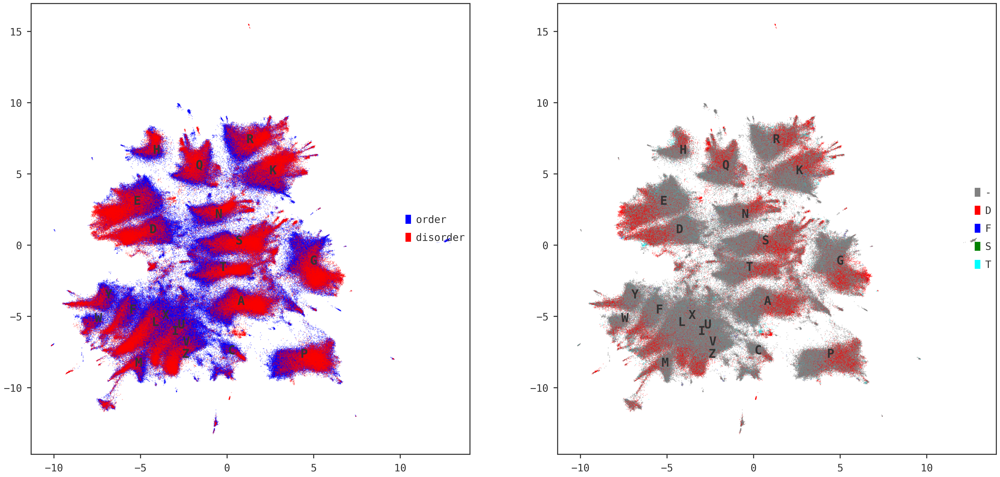

In [50]:
key = "200_0.5"
print(key)

AAs = list(set(SEQ))
cmapAA = cm.get_cmap('gist_rainbow', len(AAs))
colordictAA = dict(zip(AAs, np.arange(0, len(AAs))))

DDs = sorted(list(set(ANNOT)))
colorsDD = ["gray", "red", "blue", "green", "cyan"]
colordictDD = dict(zip(DDs, colorsDD))

aa_means = dict()
for aa in AAs:
    AAix = [x for x in range(0, len(SEQ)) if SEQ[x] == aa]
    embed_aa = umap_datadict[key][AAix,:]
    x_mean = np.mean(embed_aa[:,0])
    y_mean = np.mean(embed_aa[:,1])
    aa_means[aa] = (x_mean, y_mean)

# Aminoacid colors
fig = plt.figure(figsize=(34,16))
ax1 = fig.add_subplot(121)

ax1.scatter(umap_datadict[key][ix_annot_order,0], umap_datadict[key][ix_annot_order,1], s=1, alpha=0.2, c="blue")
ax1.scatter(umap_datadict[key][ix_annot_disorder,0], umap_datadict[key][ix_annot_disorder,1], s=1, alpha=0.2, c="red")

for aa in aa_means.keys():
    ax1.text(aa_means[aa][0], aa_means[aa][1], aa, fontsize='large', fontweight='bold')

legend_elements = [Patch(facecolor="blue", edgecolor="blue",label="order"),
                   Patch(facecolor="red", edgecolor="red",label="disorder")]
ax1.legend(handles=legend_elements, loc='right')

# # Disorder / Order colors
ax2 = fig.add_subplot(122)
ax2.scatter(umap_datadict[key][:,0], umap_datadict[key][:,1], s=1, alpha=0.2, 
           c=[colordictDD[x] for x in ANNOT])

for aa in aa_means.keys():
    ax2.text(aa_means[aa][0], aa_means[aa][1], aa, fontsize='large', fontweight='bold')

legend_elements = [Patch(facecolor=colordictDD[x], edgecolor=colordictDD[x],label=x) for x in DDs]
ax2.legend(handles=legend_elements, loc='right')
#plt.savefig(f"disprot_plotdata_OK_fullset/halft5/plots/umap_plot_{key}.png", bbox_inches='tight')
plt.show()

In [51]:
import json

with open("matches_positions_disprot.json") as instream:
    allmatches_dict = json.load(instream)

print(list(allmatches_dict.keys()))

with open("mismatches_positions_disprot.json") as instream:
    allmismatches_dict = json.load(instream)

print(list(allmismatches_dict.keys()))

['match_in_order', 'match_in_disorder', 'onsm_offsmm_order', 'onsm_offsmm_disorder']
['mismatch_order_onsite', 'mismatch_disorder_onsite']


In [54]:
allmatches_dict["onsm_offsmm_order"][:10]

['P03347_28',
 'P03347_74',
 'P03347_92',
 'P03347_122',
 'P03347_136',
 'P03347_157',
 'P03347_213',
 'P03347_278',
 'P03347_348',
 'P03347_371']

In [27]:
seqpos_dict = dict()
counter = 0
for s in sequences:
    for i,aa in enumerate(s.seq):
        seqpos_dict[f"{s.name}_{i}"] = counter
        counter += 1
print(counter)

827664


In [32]:
ix_match_in_disorder = list()
ix_match_in_order = list()
for pos in allmatches_dict["match_in_disorder"]:
    ix_match_in_disorder.append(seqpos_dict[pos])
for pos in allmatches_dict["match_in_order"]:
    ix_match_in_order.append(seqpos_dict[pos])

ix_match_in_order = np.array(ix_match_in_order)
ix_match_in_disorder = np.array(ix_match_in_disorder)

In [34]:
print(ix_match_in_order.shape)
print(ix_match_in_disorder.shape)

(326839,)
(69969,)


200_0.5


/tmp/ipykernel_1964185/4162735187.py:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmapAA = cm.get_cmap('gist_rainbow', len(AAs))


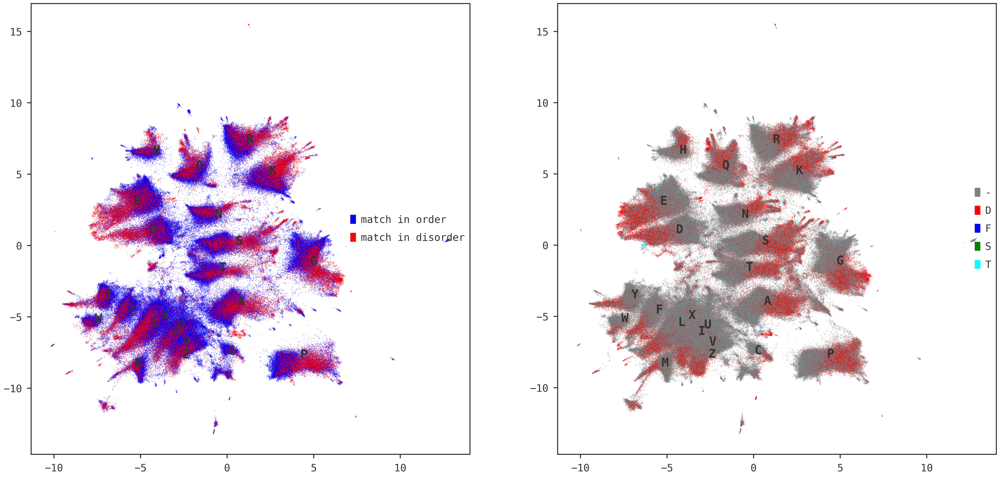

In [36]:
key = "200_0.5"
print(key)
    
AAs = list(set(SEQ))
cmapAA = cm.get_cmap('gist_rainbow', len(AAs))
colordictAA = dict(zip(AAs, np.arange(0, len(AAs))))

DDs = sorted(list(set(ANNOT)))
colorsDD = ["gray", "red", "blue", "green", "cyan"]
colordictDD = dict(zip(DDs, colorsDD))

aa_means = dict()
for aa in AAs:
    AAix = [x for x in range(0, len(SEQ)) if SEQ[x] == aa]
    embed_aa = umap_datadict[key][AAix,:]
    x_mean = np.mean(embed_aa[:,0])
    y_mean = np.mean(embed_aa[:,1])
    aa_means[aa] = (x_mean, y_mean)

# Aminoacid colors
fig = plt.figure(figsize=(34,16))
ax1 = fig.add_subplot(121)
# ax1.scatter(umap_datadict[key][:,0], umap_datadict[key][:,1], s=1, alpha=0.2, 
#            c=[cmapAA(colordictAA[x]) for x in SEQ])

# for aa in aa_means.keys():
#     ax1.text(aa_means[aa][0], aa_means[aa][1], aa, fontsize='large', fontweight='bold')

# legend_elements = [Patch(facecolor=cmapAA(colordictAA[x]), edgecolor=cmapAA(colordictAA[x]),label=x) for x in AAs]
# ax1.legend(handles=legend_elements, loc='right')
ax1.scatter(umap_datadict[key][ix_match_in_order,0], umap_datadict[key][ix_match_in_order,1], s=1, alpha=0.2, c="blue")
ax1.scatter(umap_datadict[key][ix_match_in_disorder,0], umap_datadict[key][ix_match_in_disorder,1], s=1, alpha=0.2, c="red")

for aa in aa_means.keys():
    ax1.text(aa_means[aa][0], aa_means[aa][1], aa, fontsize='large', fontweight='bold')

legend_elements = [Patch(facecolor="blue", edgecolor="blue",label="match in order"),
                   Patch(facecolor="red", edgecolor="red",label="match in disorder")]
ax1.legend(handles=legend_elements, loc='right')

# Disorder / Order colors
ax2 = fig.add_subplot(122)
ax2.scatter(umap_datadict[key][:,0], umap_datadict[key][:,1], s=1, alpha=0.2, 
           c=[colordictDD[x] for x in ANNOT])

for aa in aa_means.keys():
    ax2.text(aa_means[aa][0], aa_means[aa][1], aa, fontsize='large', fontweight='bold')

legend_elements = [Patch(facecolor=colordictDD[x], edgecolor=colordictDD[x],label=x) for x in DDs]
ax2.legend(handles=legend_elements, loc='right')
#plt.savefig(f"disprot_plotdata_OK_fullset/halft5/plots/umap_plot_{key}.png", bbox_inches='tight')
plt.show()